# `l2hmc`: Example

<a href="https://arxiv.org/abs/2105.03418"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2105.03418-B31B1B.svg" align="left"></a> <a href="https://arxiv.org/abs/2112.01582"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2112.01582-B31B1B.svg" align="left" style="margin-left:10px;"></a><br>


This notebook will (attempt) to walk through the steps needed to successfully instantiate and "run" an experiment.

For this example, we wish to train the L2HMC sampler for the 2D $U(1)$ lattice gauge model with Wilson action:

$$\begin{equation*}
S_{\beta}(n) = \beta \sum_{n}\sum_{\mu<\nu}\mathrm{Re}\left[1 - U_{\mu\nu}(n) \right]
\end{equation*}$$

This consists of the following steps:
  1. Build an `Experiment` by parsing our configuration object
  2. Train our model using the `Experiment.train()` method
  3. Evaluate our trained model `Experiment.evaluate(job_type='eval')`
  4. Compare our trained models' performance against generic HMC `Experiment.evaluate(job_type='hmc')`
  

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.1);color:#666666; border-radius:5px; border: none;">
<span style="font-weight:700; font-size:1.5em;">Evaluating Performance</span>
    
Explicitly, we measure the performance of our model by comparing the _tunneling rate_ $\delta Q$ of our **trained** sampler to that of generic HMC.
    
Explicitly, the tunneling rate is given by:
    
$$
\delta Q = \frac{1}{N_{\mathrm{chains}}}\sum_{\mathrm{chains}} \left|Q_{i+1} - Q_{i}\right|
$$
    
where the difference is between subsequent states in a chain, and the sum is over all $N$ chains (each being ran in parallel, _independently_).
    
Since our goal is to generate _independent configurations_, the more our sampler tunnels between different topological sectors (_tunneling rate_), the more efficient our sampler.
    
</div>

## Imports / Setup

In [ ]:
! nvidia-smi | tail --lines -7

In [1]:
# automatically detect and reload local changes to modules
%load_ext autoreload
%autoreload 2
%matplotlib widget

import os
import warnings

os.environ['COLORTERM'] = 'truecolor'

warnings.filterwarnings('ignore')
# --------------------------------------
# BE SURE TO GRAB A FRESH GPU !
os.environ['CUDA_VISIBLE_DEVICES'] = '2'
!echo $CUDA_VISIBLE_DEVICES
# --------------------------------------

2


In [2]:
devices = os.environ.get('CUDA_VISIBLE_DEVICES', None)
print(devices)
!getconf _NPROCESSORS_ONLN  # get number of availble CPUs

2
256


In [3]:
os.environ['TORCH_CPP_LOG_LEVEL'] = 'ERROR'
os.environ['AUTOGRAPH_VERBOSITY'] = '10'
!echo $CUDA_VISIBLE_DEVICES

2


In [4]:
from __future__ import absolute_import, print_function, annotations, division
import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import set_matplotlib_formats

from l2hmc.main import build_experiment
from l2hmc.utils.rich import get_console
from l2hmc.utils.plot_helpers import set_plot_style

set_plot_style()
plt.rcParams['grid.alpha'] = 0.8
plt.rcParams['grid.color'] = '#404040'
sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")
set_matplotlib_formats('retina')
plt.rcParams['figure.figsize'] = [12.4, 4.8]

console = get_console()
print(console.is_jupyter)
if console.is_jupyter:
    console.is_jupyter = False
print(console.is_jupyter)

--------------------------------------------------------------------------

  Local host:   thetagpu23
  Local device: mlx5_0
--------------------------------------------------------------------------


True

False


In [5]:
import l2hmc
l2hmc.__file__

'/lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd/src/l2hmc/__init__.py'

# Initialize and Build `Experiment` objects:

- The `l2hmc.main` module provides a function `build_experiment`:

```python
def build_experiment(overrides: list[str]) -> tfExperiment | ptExperiment:
    ...
```

which will:

1. Load the default options from `conf/config.yaml`
2. Override the default options with any values provided in `overrides`
3. Parse these options and build an `ExperimentConfig` which uniquely defines an experiment
3. Instantiate / return an `Experiment` from the `ExperimentConfig`.
   Depending on `framework=pytorch|tensorflow`:
    a. `framework=pytorch` -> `l2hmc.experiment.pytorch.Experiment`
    b. `framework=tensorflow` -> `l2hmc.experiment.tensorflow.Experiment`

```python
>>> train_output = experiment.train()
>>> eval_output = experiment.evaluate(job_type='eval')
>>> hmc_output = experiment.evaluate(job_type='hmc')
```

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.2);color:rgb(102,102,102); border-radius:5px; border:none">
<b><u>Overriding Defaults</u></b>

Specifics about the training / evaluation / hmc runs can be flexibly overridden by passing arguments to the training / evaluation / hmc runs, respectively
</div>

In [6]:
import numpy as np

#seed = np.random.randint(100000)
seed=76043

DEFAULTS = {
    'seed': f'{seed}',
    'precision': 'fp16',
    'init_aim': False,
    'init_wandb': False,
    'use_wandb': False,
    'restore': False,
    'save': False,
    'use_tb': False,
    'dynamics': {
        'nleapfrog': 10,
        'nchains': 4096,
        'eps': 0.05,
    },
    'conv': 'none',
    'steps': {
        'log': 20,
        'print': 250,
        'nepoch': 5000,
        'nera': 1,
    },
    'annealing_schedule': {
        'beta_init': 4.0,
        'beta_final': 4.0,
    },
    #'learning_rate': {
    #    #'lr_init': 0.0005,
    #    #'clip_norm': 10.0,
    #},
}

outputs = {
    'pytorch': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
    'tensorflow': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
}

In [7]:
from l2hmc.configs import dict_to_list_of_overrides
OVERRIDES = dict_to_list_of_overrides(DEFAULTS)
OVERRIDES

['seed=76043',
 'precision=fp16',
 'init_aim=False',
 'init_wandb=False',
 'use_wandb=False',
 'restore=False',
 'save=False',
 'use_tb=False',
 'dynamics.nleapfrog=10',
 'dynamics.nchains=4096',
 'dynamics.eps=0.05',
 'conv=none',
 'steps.log=20',
 'steps.print=250',
 'steps.nepoch=5000',
 'steps.nera=1',
 'annealing_schedule.beta_init=4.0',
 'annealing_schedule.beta_final=4.0']

In [8]:
# Build PyTorch Experiment
ptExpU1 = build_experiment(
    overrides=[
        *OVERRIDES,
        'framework=pytorch',
        'backend=DDP',
    ]
)

[06/23/23 12:57:55][INFO][dist.py:338] - Global Rank: 0 / 0


2023-06-23 12:57:58.015160: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE3 SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


[06/23/23 12:58:15][INFO][dist.py:226] - Caught MASTER_PORT:2345 from environment!
[06/23/23 12:58:15][INFO][dist.py:226] - Caught MASTER_PORT:2345 from environment!
[06/23/23 12:58:15][WARNING][trainer.py:435] - Using torch.float16 on cuda!
[06/23/23 12:58:17][WARNING][trainer.py:435] - Using `torch.optim.Adam` optimizer
[06/23/23 12:58:17][INFO][trainer.py:283] - num_params in model: 1486740
[06/23/23 12:58:17][WARNING][trainer.py:250] - logging with freq 20 for wandb.watch


In [9]:
# Build TensorFlow Experiment
import tensorflow as tf
tf.keras.mixed_precision.set_global_policy('mixed_float16')

tfExpU1 = build_experiment(
    overrides=[
        *OVERRIDES,
        'framework=tensorflow',
        'backend=horovod',
    ]
)

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: NVIDIA A100-SXM4-80GB, compute capability 8.0
[06/23/23 12:58:18][INFO][dist.py:82] - 1, Physical GPUs and 1 Logical GPUs
[06/23/23 12:58:18][WARNING][dist.py:108] - Using: float32 precision
[06/23/23 12:58:18][INFO][dist.py:109] - RANK: 0, LOCAL_RANK: 0


## PyTorch

### Training

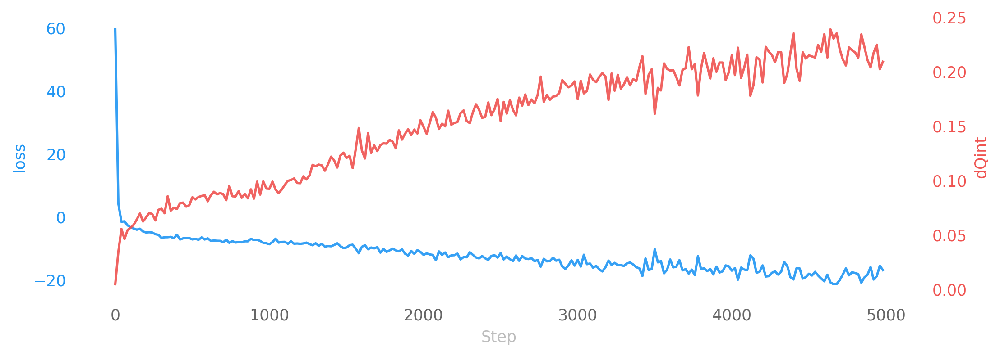

[06/23/23 12:58:19][INFO][trainer.py:439] - [TRAINING] x.dtype: torch.float32
[06/23/23 12:58:19][INFO][trainer.py:439] - [TRAINING] self._dtype: torch.float16
[06/23/23 12:58:19][INFO][trainer.py:107] - ┏━━━━━━━━━━━━━━━━━━━━━━━━━┓
[06/23/23 12:58:19][INFO][trainer.py:108] - ┃ ERA: 0 / 1, BETA: 4.000 ┃
[06/23/23 12:58:19][INFO][trainer.py:109] - ┗━━━━━━━━━━━━━━━━━━━━━━━━━┛
[06/23/23 12:58:24][INFO][trainer.py:439] - Thermalizing configs @ 4.00 took 4.7326 s
[06/23/23 12:58:25][INFO][trainer.py:1722] - era=0 epoch=0 tstep=1 dt=0.781 beta=4.000 loss=59.439 dQsin=0.016 dQint=0.005 energy=398.887 logprob=398.650 logdet=0.237 sldf=0.143 sldb=-0.117 sld=0.237 xeps=0.050 veps=0.050 acc=0.057 sumlogdet=0.003 acc_mask=0.057 plaqs=0.864 intQ=0.009 sinQ=0.006 lr=0.001
[06/23/23 13:00:59][INFO][trainer.py:1722] - era=0 epoch=240 tstep=241 dt=0.600 beta=4.000 loss=-4.980 dQsin=0.212 dQint=0.069 energy=396.331 logprob=395.966 logdet=0.365 sldf=0.199 sldb=-0.146 sld=0.365 xeps=0.044 veps=0.043 acc=0.

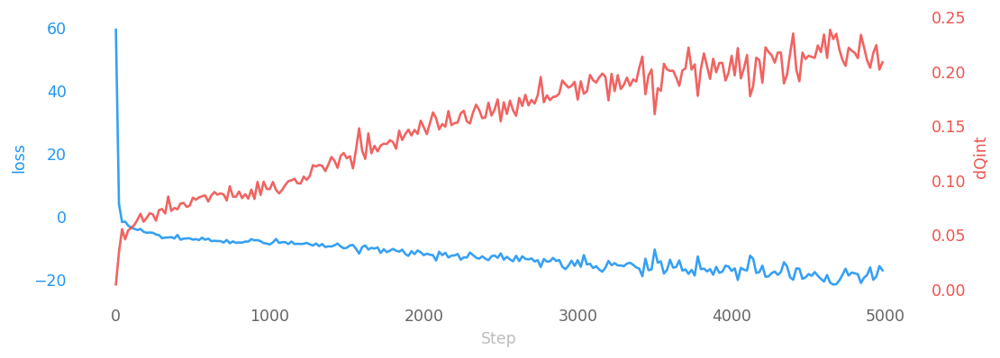

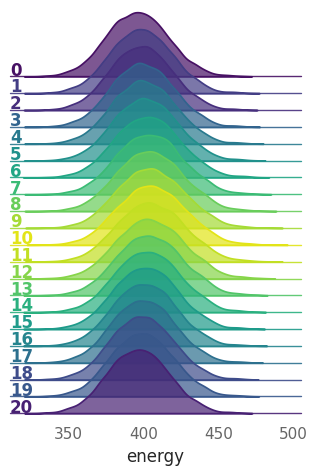

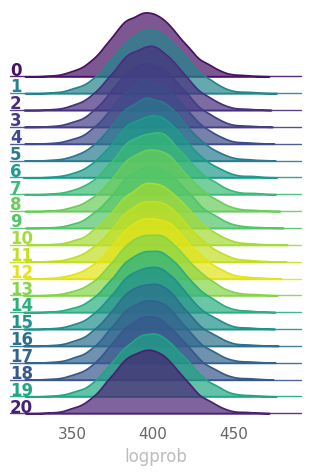

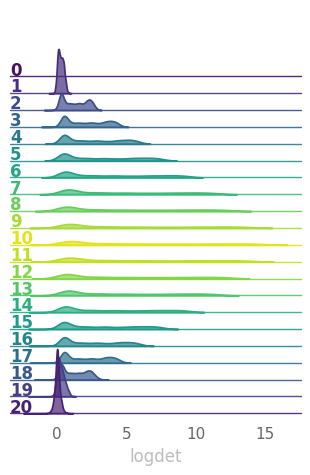

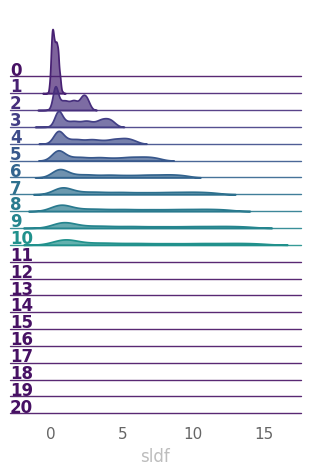

...

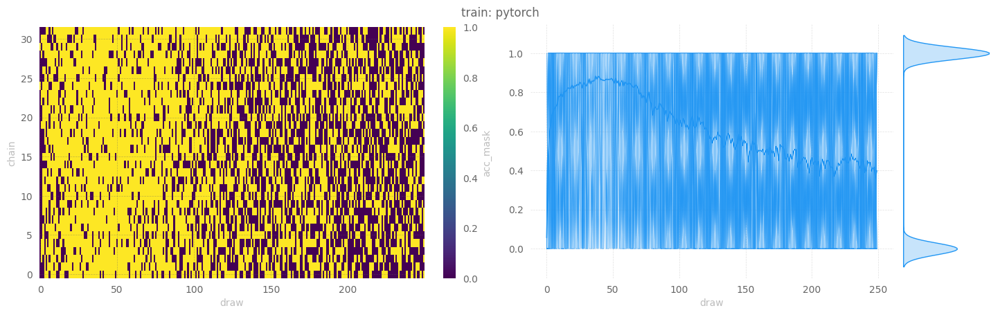

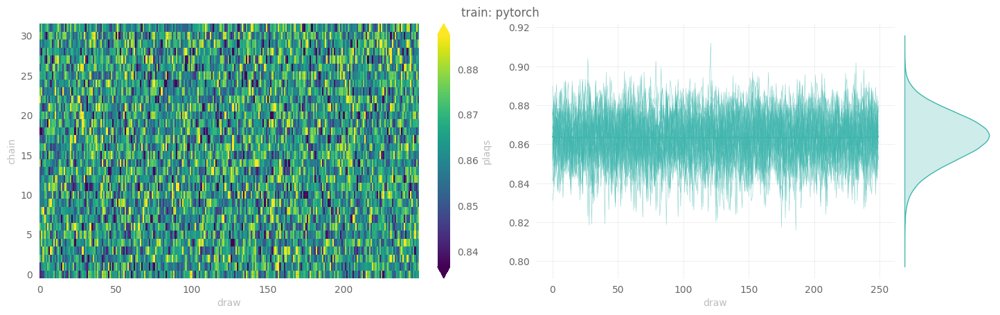

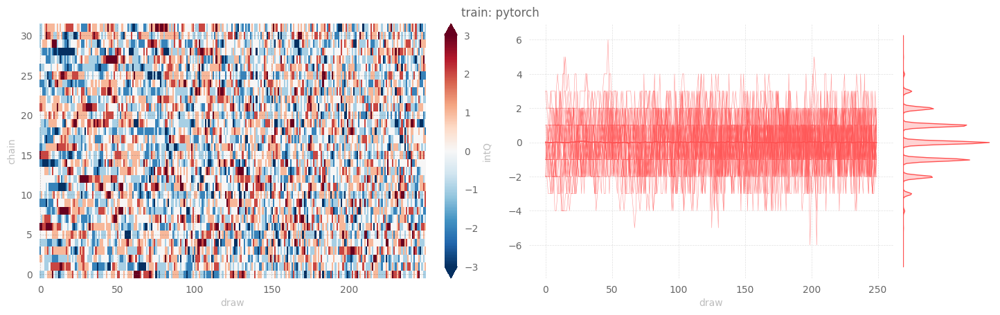

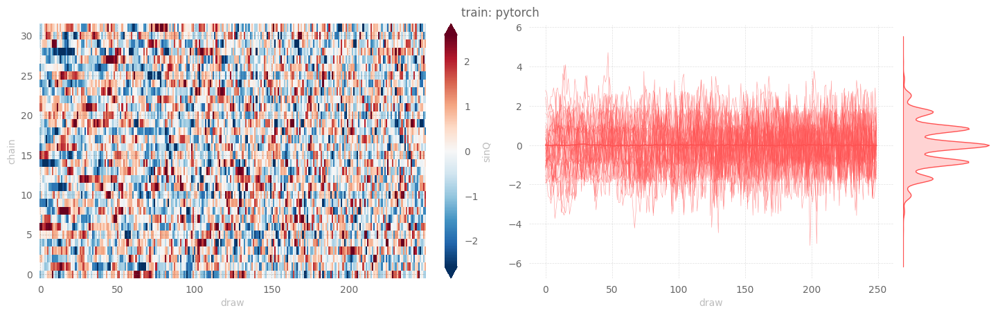

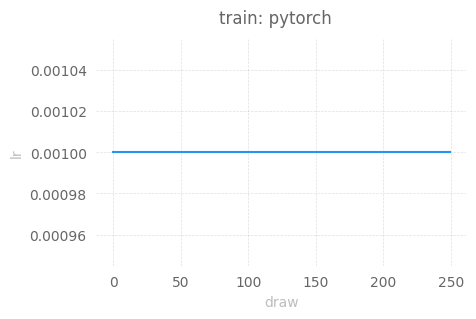

In [10]:
outputs['pytorch']['train'] = ptExpU1.trainer.train()
    #nera=5,
    #nepoch=2000,
    #beta=[4.0, 4.25, 4.5, 4.75, 5.0],
#)

_ = ptExpU1.save_dataset(job_type='train', nchains=32)

### Inference

#### Evaluation

[06/23/23 13:52:42][WARNING][trainer.py:435] - x.shape (original): torch.Size([4096, 2, 16, 16])
[06/23/23 13:52:42][WARNING][trainer.py:435] - x[:nchains].shape: torch.Size([128, 2, 16, 16])
[06/23/23 13:52:42][INFO][trainer.py:1051] - eps=None
beta=4.0
nlog=10
table=<rich.table.Table object at 0x7f2722bfbdf0>
nprint=500
eval_steps=2000
nleapfrog=None


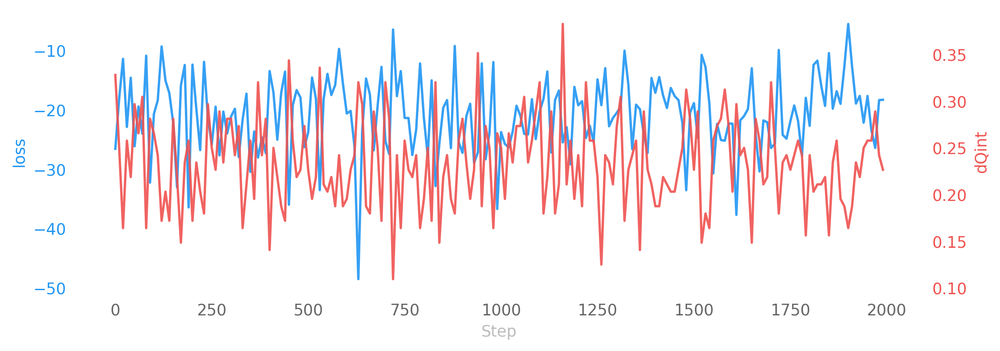

[06/23/23 13:52:46][INFO][trainer.py:1181] - estep=0 dt=0.278 beta=4.000 loss=-26.568 dQsin=0.310 dQint=0.328 energy=412.448 logprob=405.216 logdet=7.232 sldf=3.974 sldb=-3.865 sld=7.232 xeps=0.193 veps=0.148 acc=0.484 sumlogdet=0.003 acc_mask=0.508 plaqs=0.863 intQ=-0.086 sinQ=-0.055
[06/23/23 13:54:55][INFO][trainer.py:1181] - estep=500 dt=0.226 beta=4.000 loss=-23.825 dQsin=0.266 dQint=0.227 energy=407.989 logprob=400.742 logdet=7.247 sldf=3.976 sldb=-3.845 sld=7.247 xeps=0.193 veps=0.148 acc=0.470 sumlogdet=0.029 acc_mask=0.492 plaqs=0.862 intQ=-0.164 sinQ=-0.105
[06/23/23 13:57:02][INFO][trainer.py:1181] - estep=1000 dt=0.228 beta=4.000 loss=-23.745 dQsin=0.270 dQint=0.250 energy=410.211 logprob=402.944 logdet=7.266 sldf=3.987 sldb=-3.842 sld=7.266 xeps=0.193 veps=0.148 acc=0.456 sumlogdet=0.011 acc_mask=0.461 plaqs=0.863 intQ=-0.023 sinQ=-0.042
[06/23/23 13:59:11][INFO][trainer.py:1181] - estep=1500 dt=0.230 beta=4.000 loss=-18.855 dQsin=0.285 dQint=0.227 energy=408.605 logprob=4

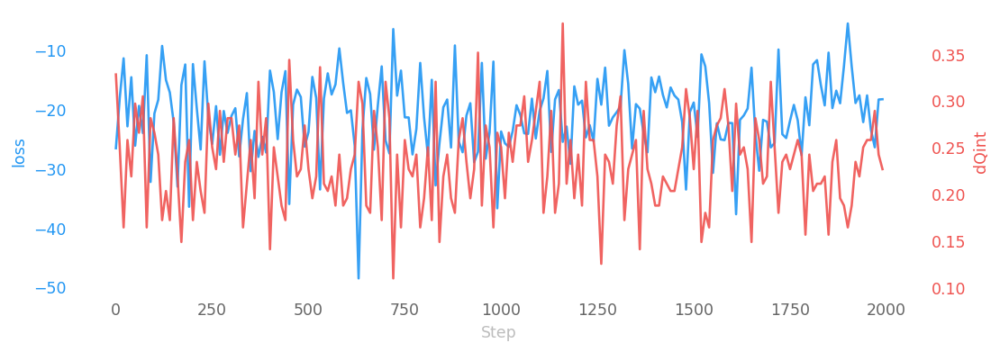

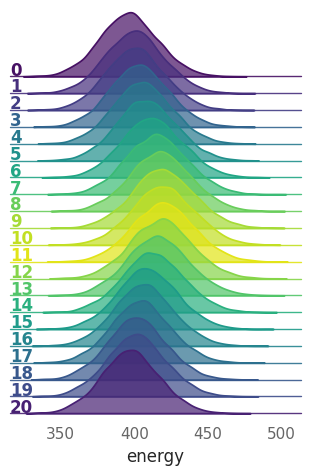

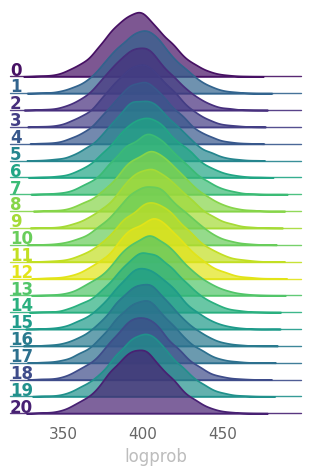

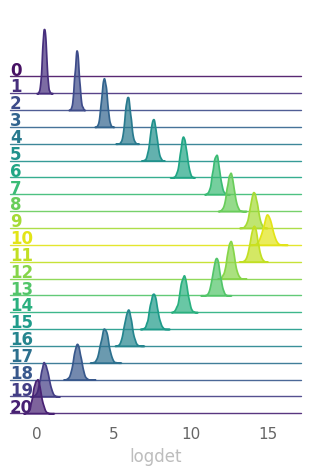

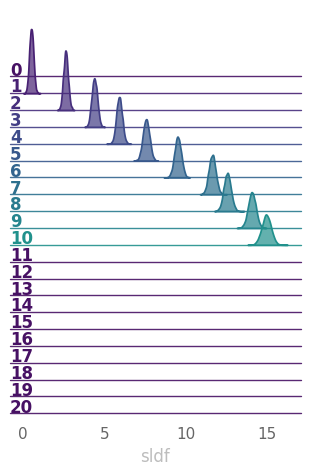

...

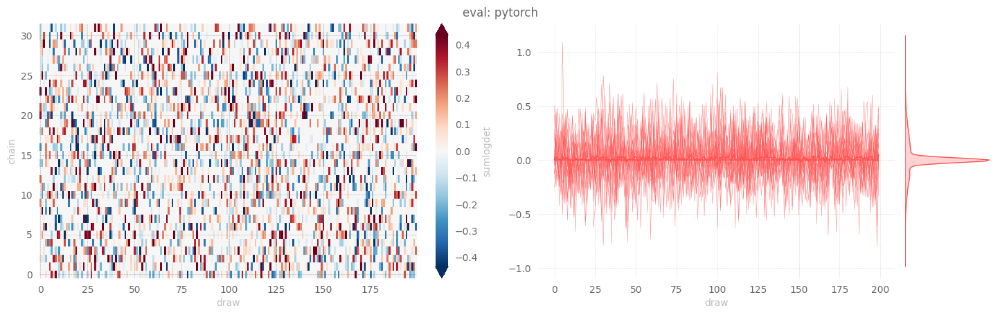

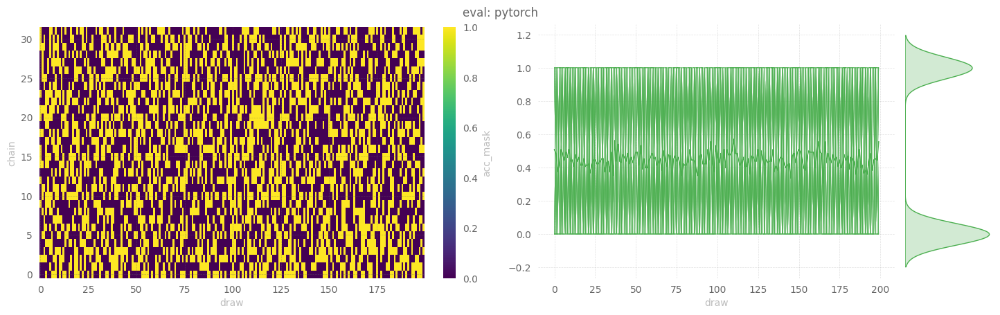

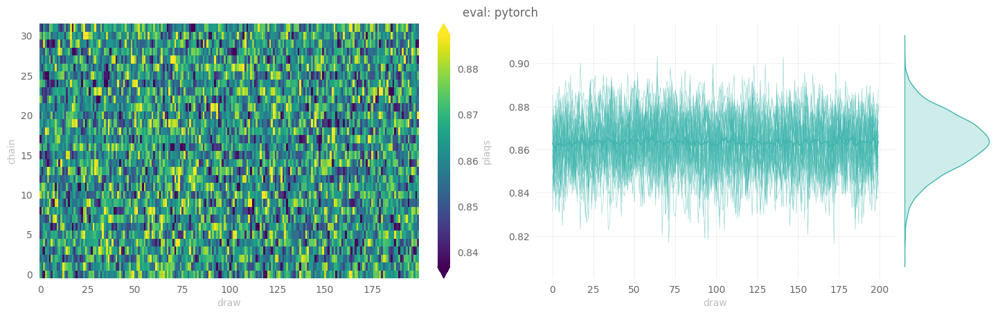

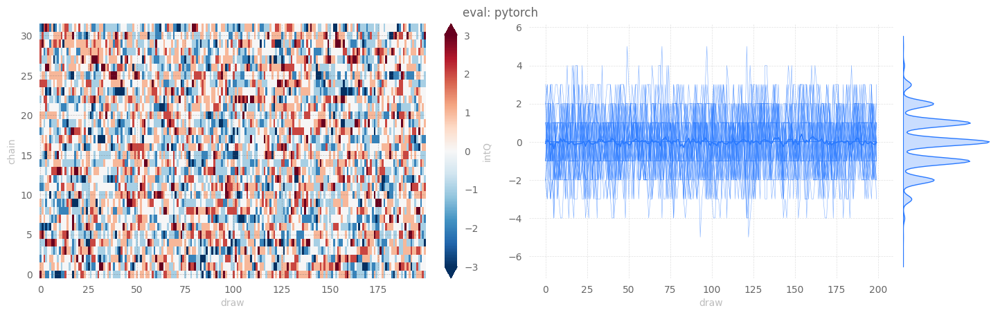

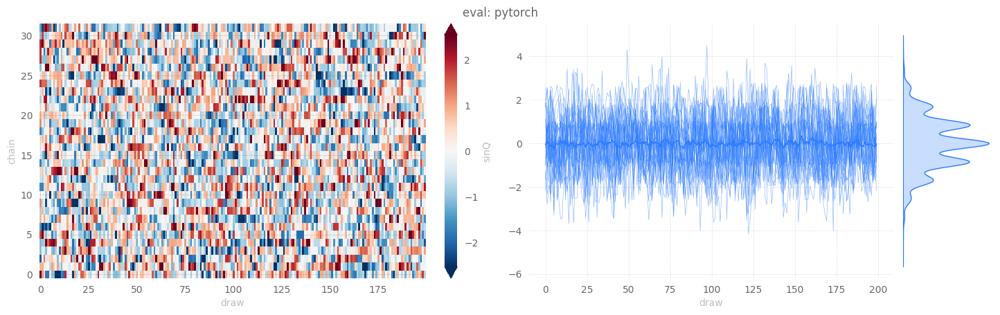

In [11]:
outputs['pytorch']['eval'] = ptExpU1.trainer.eval(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = ptExpU1.save_dataset(job_type='eval', nchains=32)

#### HMC

[06/23/23 14:02:13][WARNING][trainer.py:435] - Step size `eps` not specified for HMC! Using default: 0.1000 for generic HMC
[06/23/23 14:02:13][WARNING][trainer.py:435] - x.shape (original): torch.Size([4096, 2, 16, 16])
[06/23/23 14:02:13][WARNING][trainer.py:435] - x[:nchains].shape: torch.Size([128, 2, 16, 16])
[06/23/23 14:02:13][INFO][trainer.py:1051] - eps=0.1
beta=4.0
nlog=10
table=<rich.table.Table object at 0x7f266407a500>
nprint=500
eval_steps=2000
nleapfrog=20


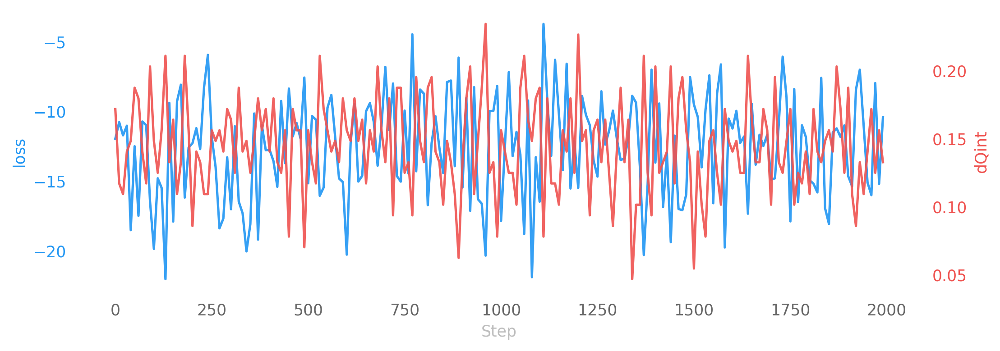

[06/23/23 14:02:17][INFO][trainer.py:1181] - hstep=0 dt=0.034 beta=4.000 loss=-11.965 dQsin=0.256 dQint=0.172 energy=395.464 logprob=395.464 logdet=0.000 acc=0.762 sumlogdet=0.000 acc_mask=0.734 plaqs=0.864 intQ=0.203 sinQ=0.148
[06/23/23 14:02:47][INFO][trainer.py:1181] - hstep=500 dt=0.035 beta=4.000 loss=-15.159 dQsin=0.263 dQint=0.156 energy=395.520 logprob=395.520 logdet=0.000 acc=0.771 sumlogdet=0.000 acc_mask=0.734 plaqs=0.864 intQ=-0.078 sinQ=-0.086
[06/23/23 14:03:20][INFO][trainer.py:1181] - hstep=1000 dt=0.035 beta=4.000 loss=-17.856 dQsin=0.307 dQint=0.156 energy=395.126 logprob=395.126 logdet=0.000 acc=0.832 sumlogdet=0.000 acc_mask=0.859 plaqs=0.864 intQ=0.125 sinQ=0.102
[06/23/23 14:03:52][INFO][trainer.py:1181] - hstep=1500 dt=0.035 beta=4.000 loss=-9.512 dQsin=0.242 dQint=0.055 energy=397.486 logprob=397.486 logdet=0.000 acc=0.791 sumlogdet=0.000 acc_mask=0.812 plaqs=0.863 intQ=-0.148 sinQ=-0.106
[06/23/23 14:04:26][INFO][plot_helpers.py:1005] - Saving figure to: /lus/

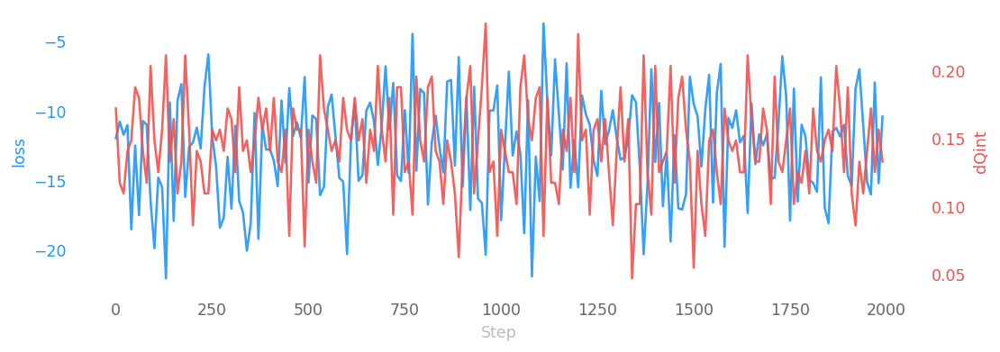

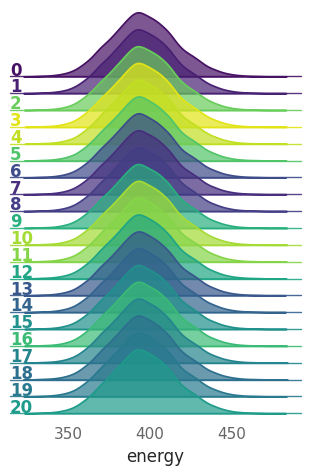

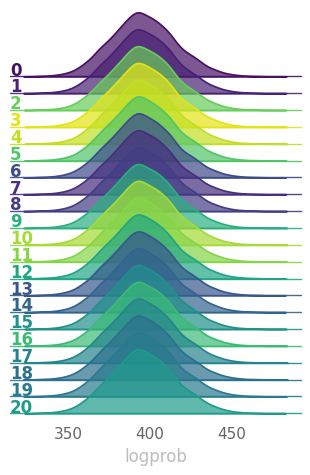

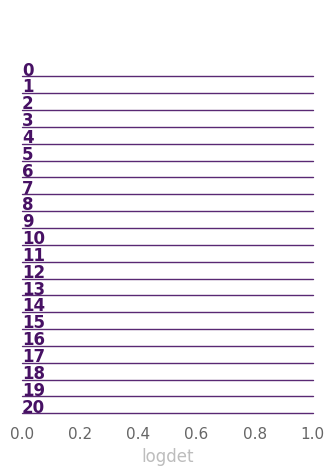

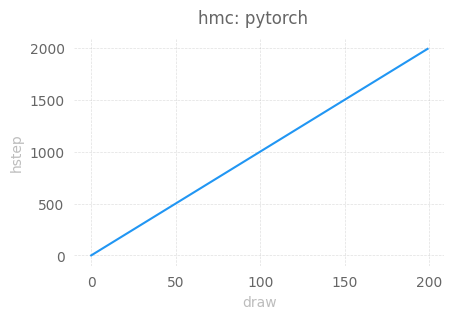

...

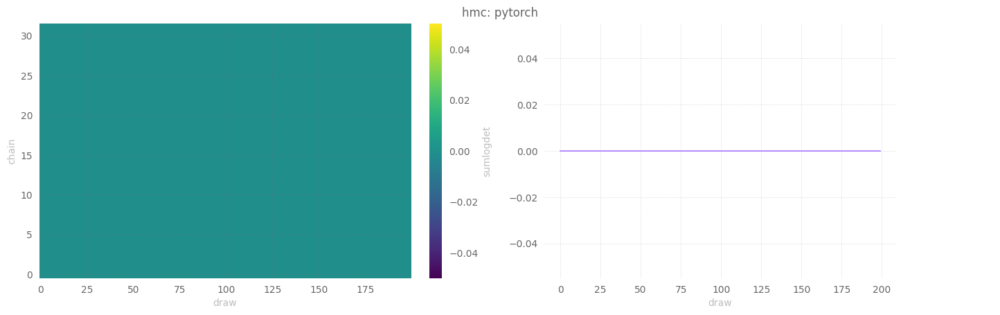

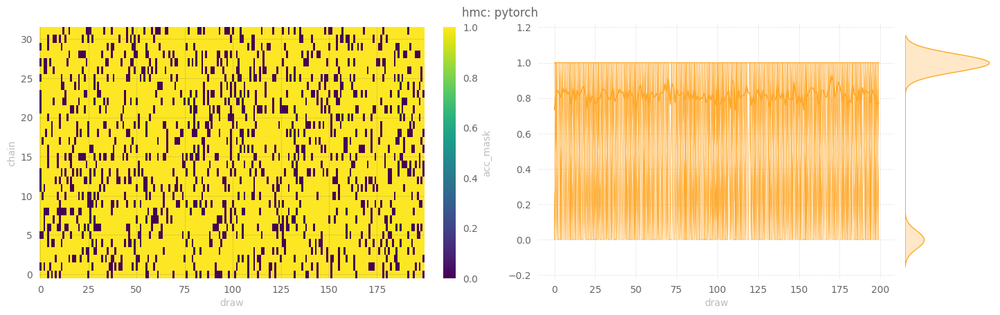

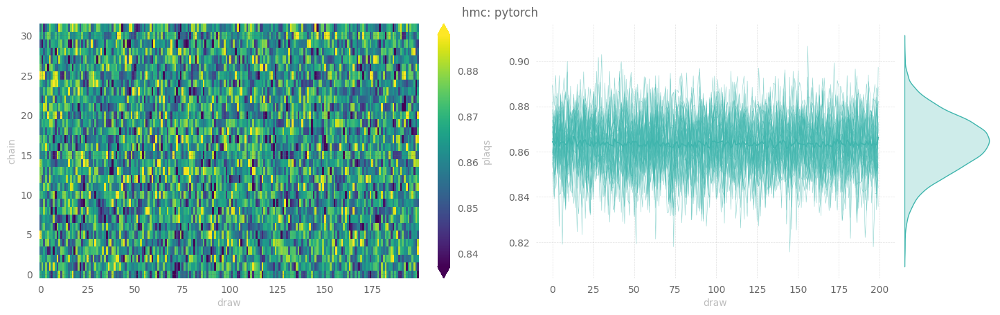

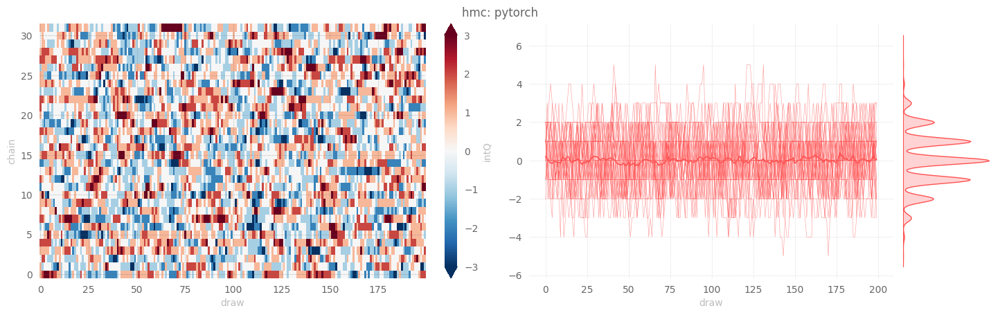

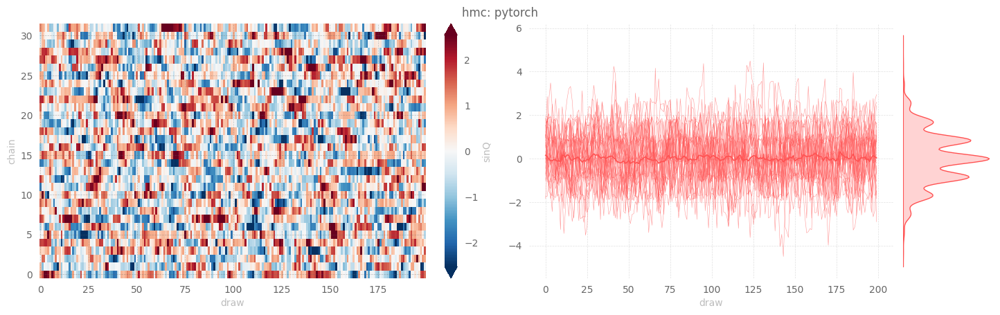

In [12]:
outputs['pytorch']['hmc'] = ptExpU1.trainer.eval(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = ptExpU1.save_dataset(job_type='hmc', nchains=32)

## TensorFlow

### Train

[06/23/23 14:05:07][INFO][trainer.py:200] - Looking for checkpoints in: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow
[06/23/23 14:05:07][INFO][trainer.py:200] - No checkpoints found to load from. Continuing


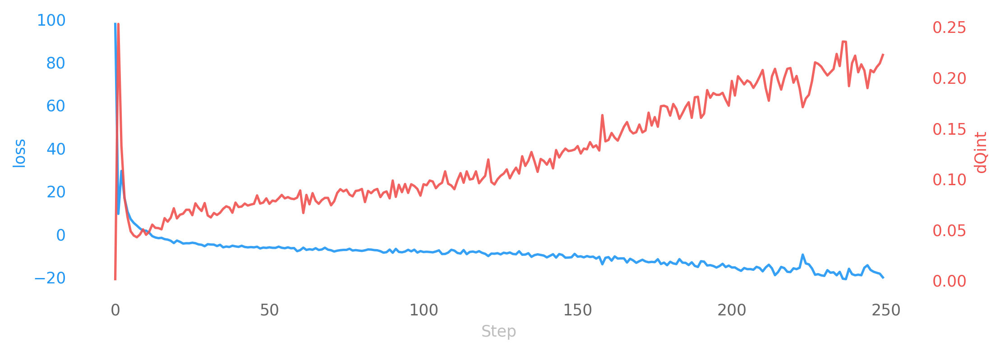

[06/23/23 14:05:07][INFO][trainer.py:1266] - ERA: 0 / 1, BETA: 4.000
[06/23/23 14:06:32][INFO][trainer.py:200] - Thermalizing configs @ 4.00 took 85.1316 s


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089
[06/23/23 14:08:07][INFO][trainer.py:1089] - era=0 epoch=0 tstep=1.000 dt=93.926 beta=4.000 loss=97.795 dQsin=0.001 dQint=0.001 energy=1281.699 logprob=1281.654 logdet=0.046 sldf=0.060 sldb=0.094 sld=0.046 xeps=0.050 veps=0.050 acc=0.001 sumlogdet=-0.001 acc_mask=0.001 plaqs=0.021 intQ=-0.042 sinQ=0.020 lr=0.001
[06/23/23 14:09:11][INFO][trainer.py:1089] - era=0 epoch=240 tstep=241.000 dt=0.239 beta=4.000 loss=-0.984 dQsin=0.153 dQint=0.055 energy=395.706 logprob=396.037 logdet=-0.332 sldf=-0.175 sldb=0.045 sld=-0.332 xeps=0.048 veps=0.044 acc=0.550 sumlogdet=0.004 acc_mask=0.555 plaqs=0.864 intQ=0.010 sinQ=0.003 lr=0.001
[06/23/23 14:10:15][INFO][trainer.py:1089] - era=0 epoch=500 tstep=501.000 dt=0.241 beta=4.000 loss=-4.051 dQsin=0.190 dQint=0.064 energy=394.337 logprob=395.721 logdet=

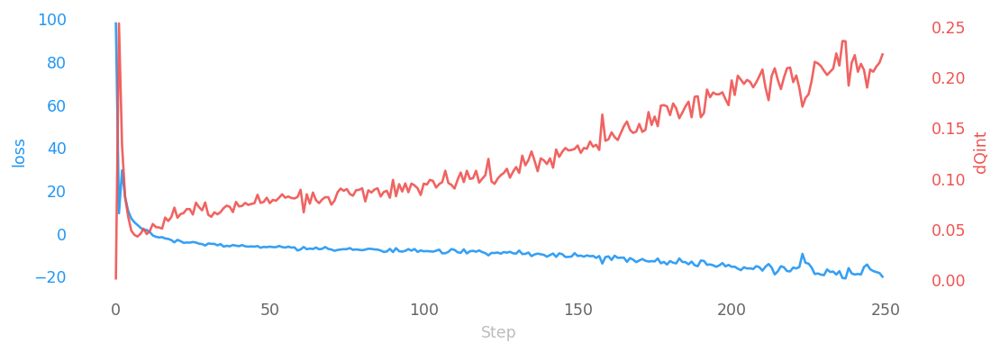

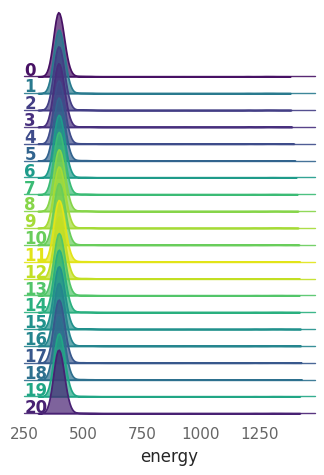

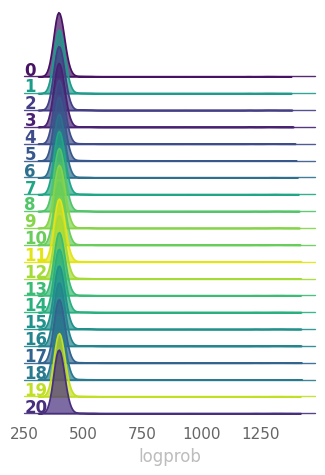

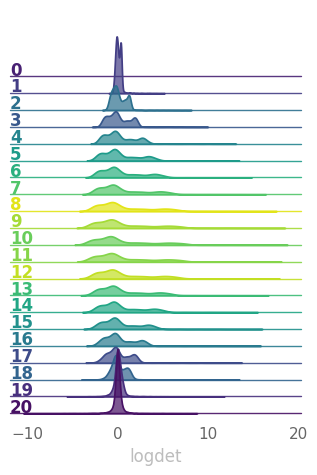

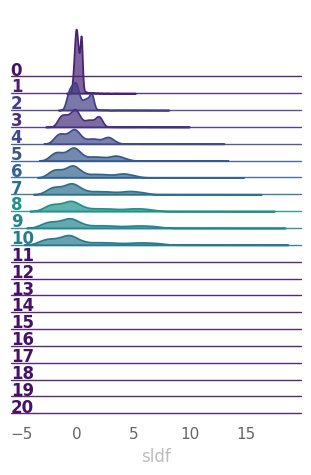

...

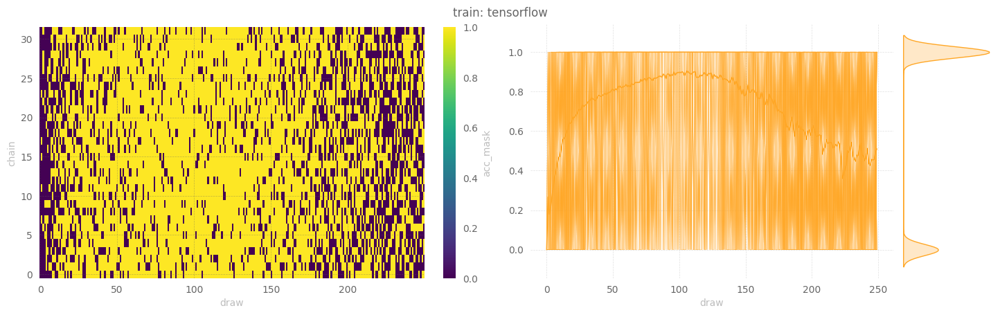

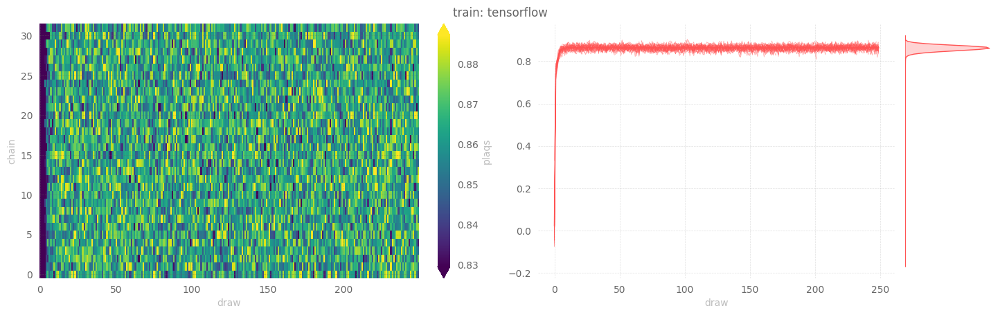

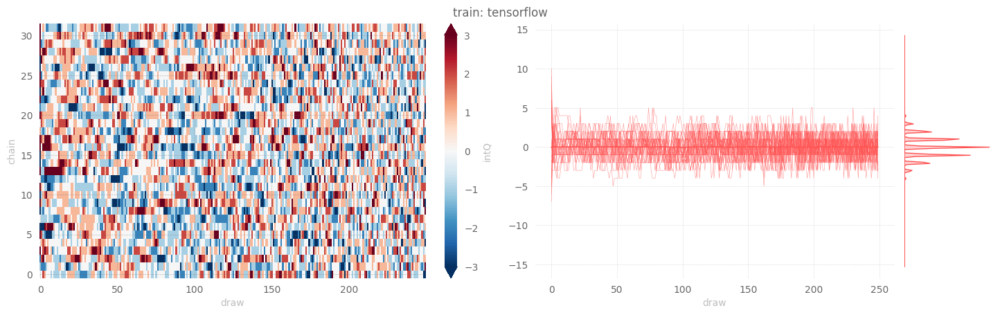

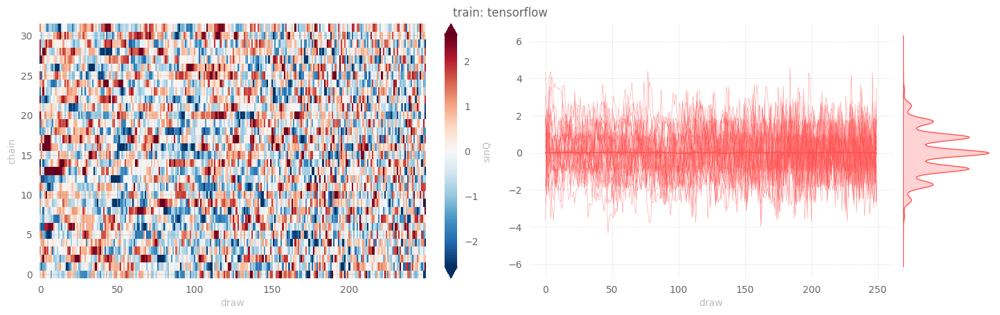

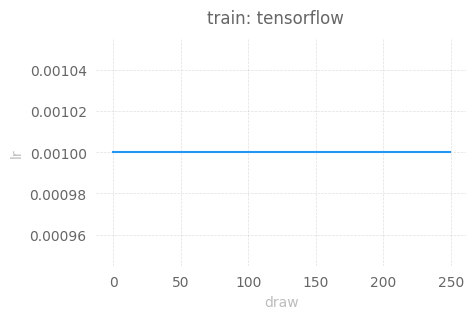

In [13]:
outputs['tensorflow']['train'] = tfExpU1.trainer.train()
#    nera=5,
#    nepoch=2000,
#    beta=[4.0, 4.25, 4.5, 4.75, 5.0],
#)
_ = tfExpU1.save_dataset(job_type='train', nchains=32)

### Inference

#### Evaluate

[06/23/23 14:31:23][WARNING][trainer.py:196] - x.shape (original): (4096, 2, 16, 16)
[06/23/23 14:31:23][WARNING][trainer.py:196] - x[:nchains].shape: (128, 2, 16, 16)
[06/23/23 14:31:23][INFO][trainer.py:200] - eps = None
beta = 4.0
nlog = 10
table = <rich.table.Table object at 0x7f26042c9e70>
nprint = 500
eval_steps = 2000
nleapfrog = None


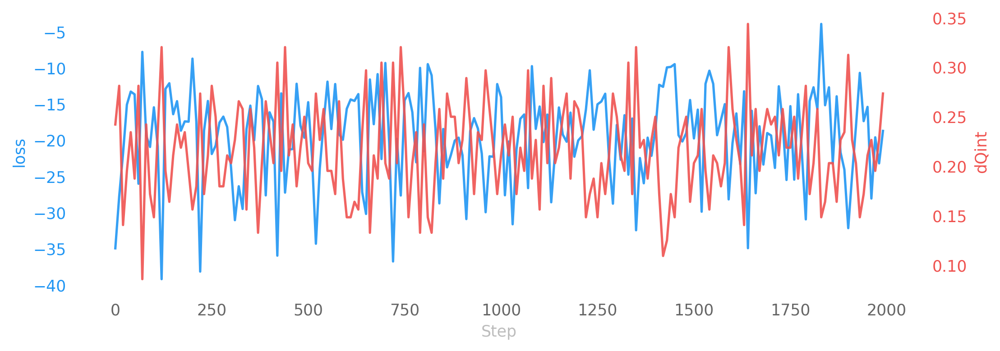

  0%|          | 0/2000 [00:00<?, ?it/s]

[06/23/23 14:33:00][INFO][trainer.py:200] - estep=0 dt=13.921 beta=4.000 loss=-34.934 dQsin=0.296 dQint=0.242 energy=402.696 logprob=398.796 logdet=3.900 sldf=2.138 sldb=-1.896 sld=3.900 xeps=0.183 veps=0.124 acc=0.472 sumlogdet=0.008 acc_mask=0.469 plaqs=0.865 intQ=0.094 sinQ=0.060
[06/23/23 14:33:49][INFO][trainer.py:200] - estep=500 dt=0.049 beta=4.000 loss=-14.736 dQsin=0.258 dQint=0.203 energy=404.299 logprob=400.366 logdet=3.932 sldf=2.151 sldb=-1.896 sld=3.932 xeps=0.183 veps=0.124 acc=0.456 sumlogdet=-0.009 acc_mask=0.500 plaqs=0.862 intQ=-0.211 sinQ=-0.169
[06/23/23 14:34:27][INFO][trainer.py:200] - estep=1000 dt=0.048 beta=4.000 loss=-14.039 dQsin=0.233 dQint=0.211 energy=403.103 logprob=399.185 logdet=3.917 sldf=2.142 sldb=-1.890 sld=3.917 xeps=0.183 veps=0.124 acc=0.477 sumlogdet=0.034 acc_mask=0.477 plaqs=0.864 intQ=0.070 sinQ=0.055
[06/23/23 14:35:05][INFO][trainer.py:200] - estep=1500 dt=0.048 beta=4.000 loss=-19.743 dQsin=0.225 dQint=0.203 energy=402.832 logprob=398.931

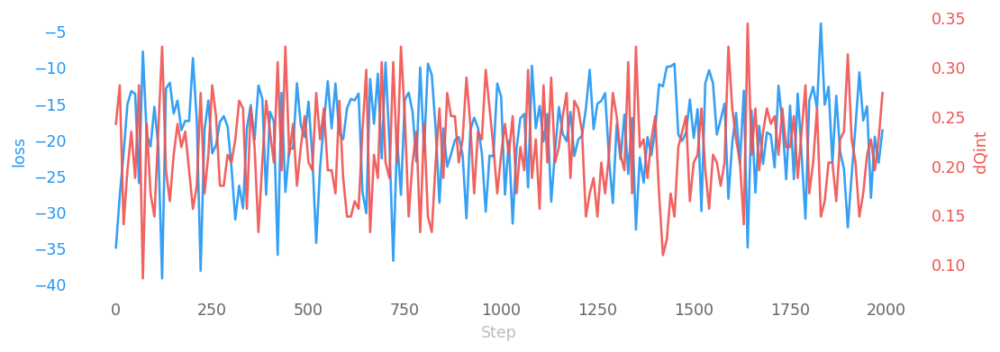

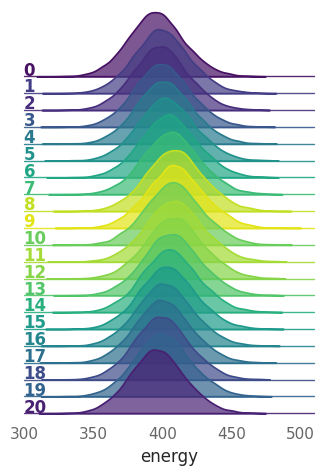

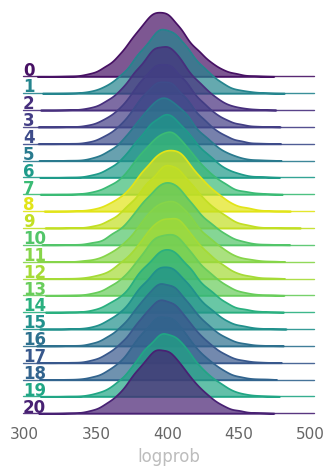

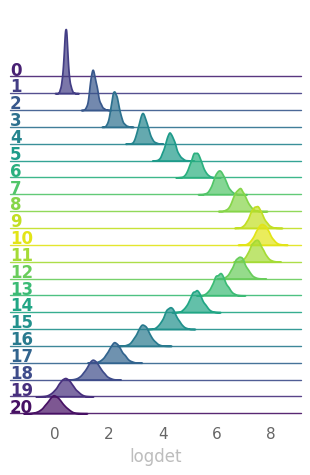

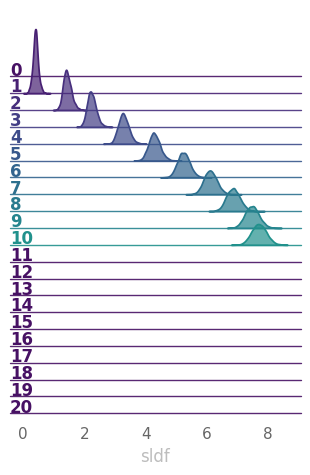

...

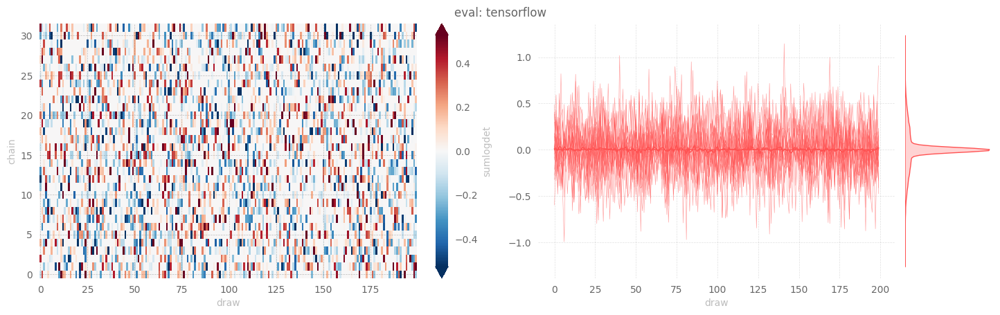

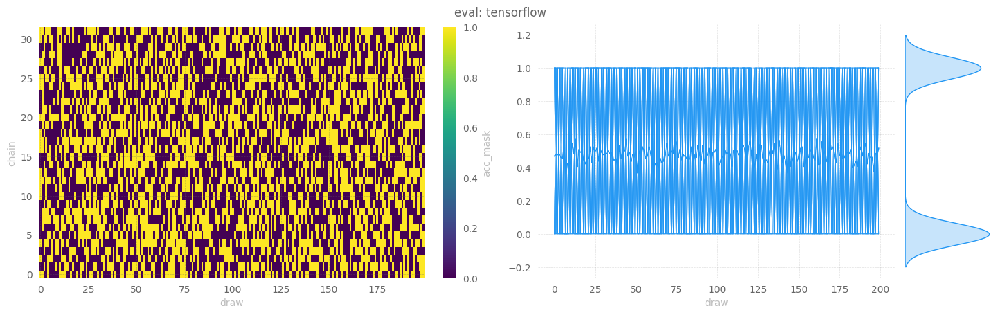

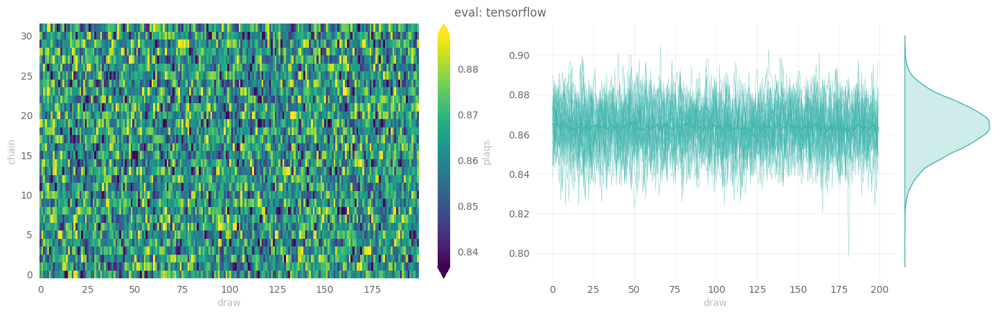

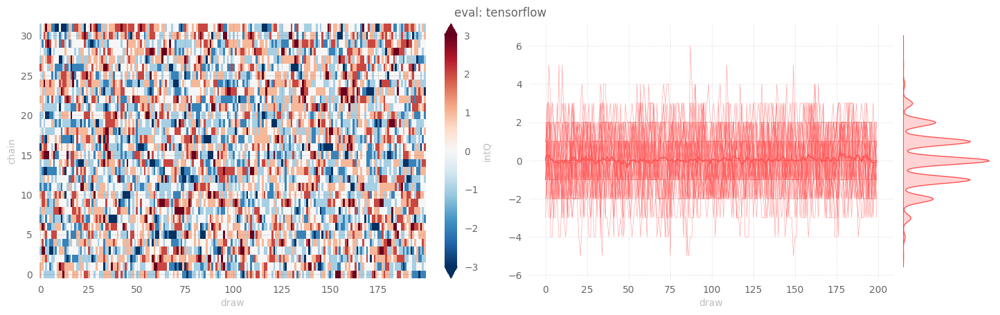

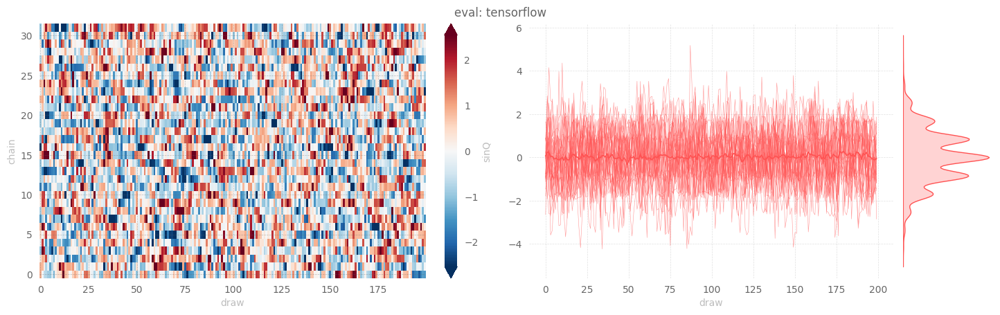

In [14]:
outputs['tensorflow']['eval'] = tfExpU1.trainer.eval(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = tfExpU1.save_dataset(job_type='eval', nchains=32)

#### HMC

[06/23/23 14:36:40][WARNING][trainer.py:196] - Step size `eps` not specified for HMC! Using default: 0.1000 for generic HMC
[06/23/23 14:36:40][WARNING][trainer.py:196] - x.shape (original): (4096, 2, 16, 16)
[06/23/23 14:36:40][WARNING][trainer.py:196] - x[:nchains].shape: (128, 2, 16, 16)
[06/23/23 14:36:40][INFO][trainer.py:200] - eps = 0.1
beta = 4.0
nlog = 10
table = <rich.table.Table object at 0x7f17f07da080>
nprint = 500
eval_steps = 2000
nleapfrog = 20


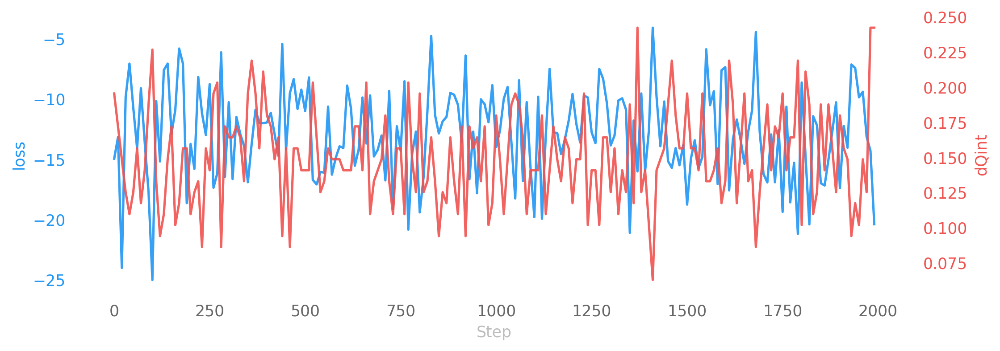

  0%|          | 0/2000 [00:00<?, ?it/s]

[06/23/23 14:38:03][INFO][trainer.py:200] - hstep=0 dt=0.197 beta=4.000 loss=-14.990 dQsin=0.288 dQint=0.195 energy=397.008 logprob=397.008 logdet=0.000 acc=0.822 sumlogdet=0.000 acc_mask=0.828 plaqs=0.862 intQ=-0.148 sinQ=-0.153
[06/23/23 14:39:55][INFO][trainer.py:200] - hstep=500 dt=0.193 beta=4.000 loss=-11.040 dQsin=0.261 dQint=0.141 energy=396.582 logprob=396.582 logdet=0.000 acc=0.815 sumlogdet=0.000 acc_mask=0.781 plaqs=0.862 intQ=0.055 sinQ=0.060
[06/23/23 14:41:47][INFO][trainer.py:200] - hstep=1000 dt=0.193 beta=4.000 loss=-14.025 dQsin=0.287 dQint=0.180 energy=395.838 logprob=395.838 logdet=0.000 acc=0.818 sumlogdet=0.000 acc_mask=0.836 plaqs=0.863 intQ=-0.117 sinQ=-0.090
[06/23/23 14:43:39][INFO][trainer.py:200] - hstep=1500 dt=0.193 beta=4.000 loss=-18.793 dQsin=0.300 dQint=0.195 energy=393.051 logprob=393.051 logdet=0.000 acc=0.813 sumlogdet=0.000 acc_mask=0.844 plaqs=0.862 intQ=0.047 sinQ=0.039
[06/23/23 14:45:36][INFO][plot_helpers.py:1005] - Saving figure to: /lus/gra

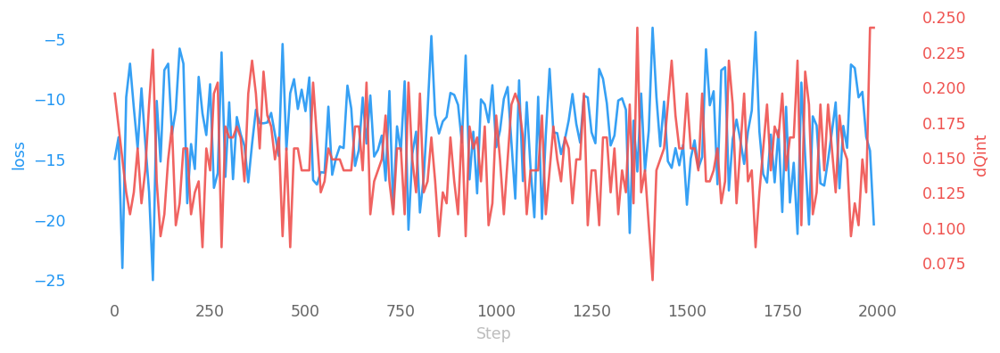

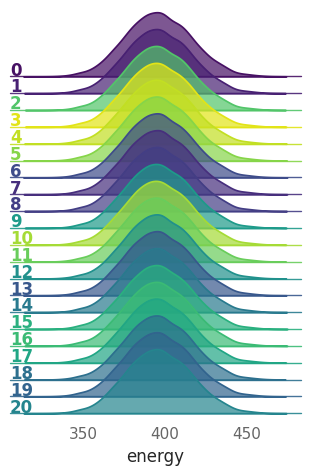

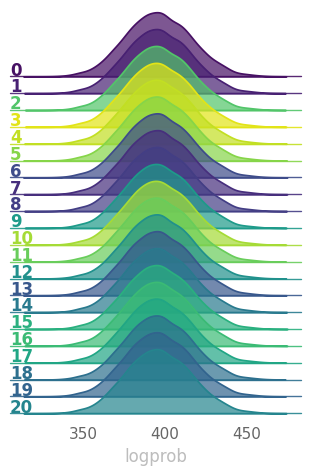

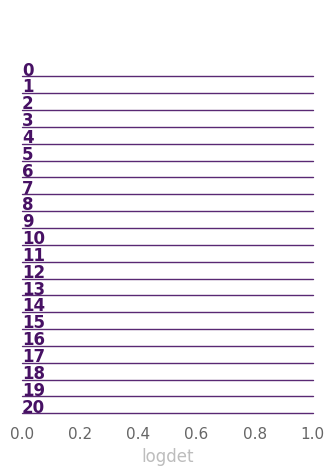

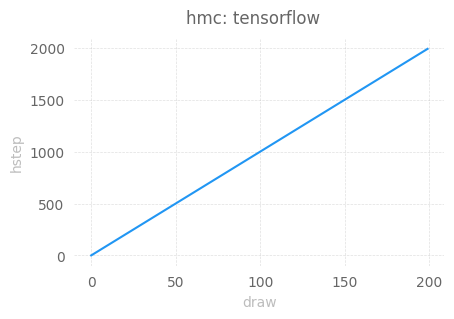

...

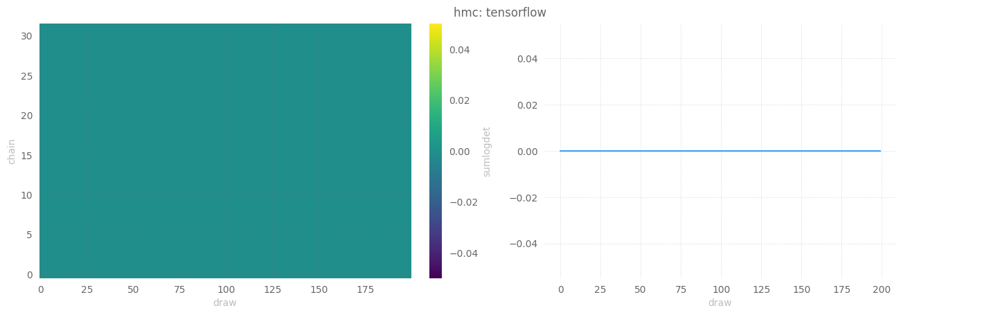

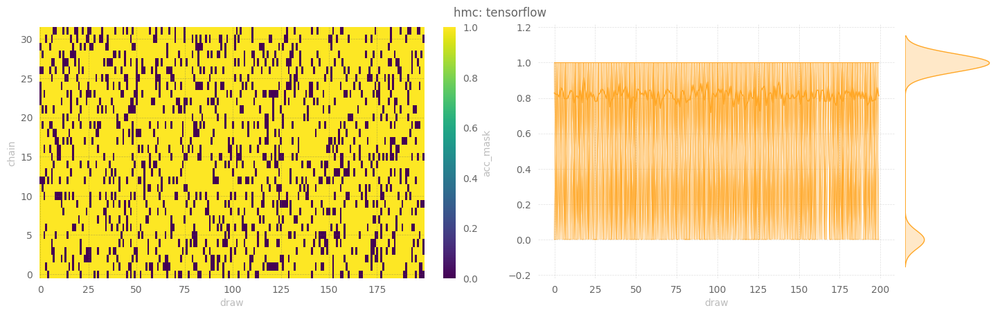

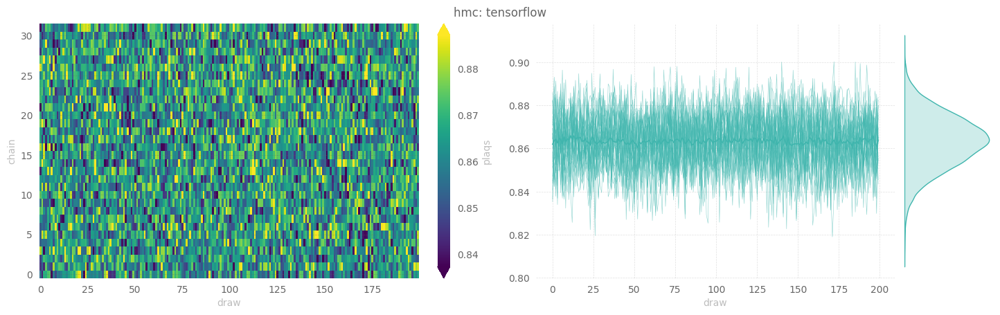

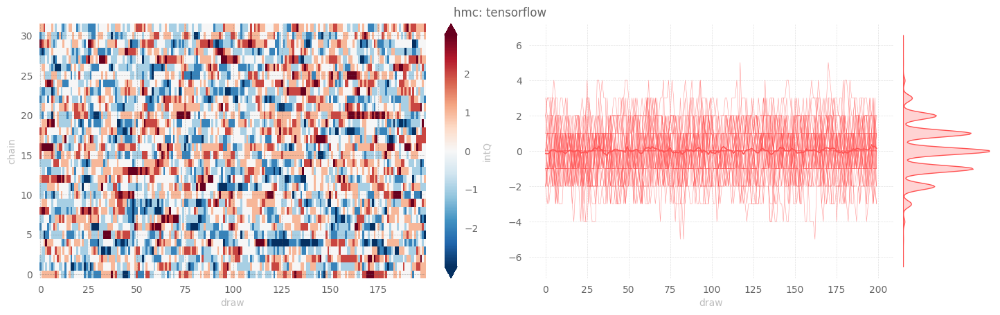

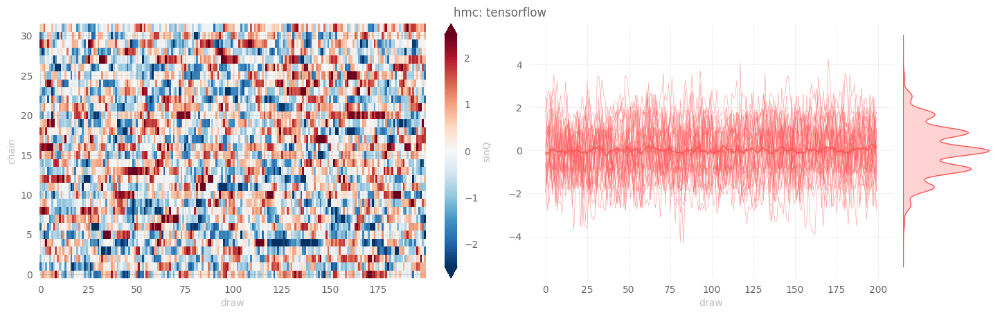

In [15]:
outputs['tensorflow']['hmc'] = tfExpU1.trainer.eval(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = tfExpU1.save_dataset(job_type='hmc', nchains=32)

# Model Performance

Our goal is improving the efficiency of our MCMC sampler.

In particular, we are interested in generating **independent** save_datasetrations which we can then use to calculate expectation values of physical observables.

For our purposes, we are interested in obtaining lattice configurations from distinct _topological charge sectors_, as characterized by a configurations _topological charge_, $Q$.

HMC is known to suffer from _critical slowing down_, a phenomenon in which our configurations remains stuck in some local topological charge sector and fails to produce distinct configurations.

In particular, it is known that the integrated autocorrelation time of the topological charge $\tau$ grows exponentially with decreasing lattice spacing (i.e. continuum limit), making this theory especially problematic.

Because of this, we can assess our models' performance by looking at the _tunneling rate_, i.e. the rate at which our sampler jumps between these different charge sectors.

We can write this quantity as:

$$
\delta Q = |Q^{(i)} - Q^{(i-1)}|
$$

where we look at the difference in the topological charge between sequential configurations.

<div class="alert alert-block alert-info" style="background:rgba(34,139,230,0.1); color: rgb(34,139,230); border: 0px solid; border-radius:5px;">
<b>Note:</b> 
The efficiency of our sampler is directly proportional to the tunneling rate, which is inversely proportional to the integrated autocorrelation time $\tau$, i.e.

&nbsp;

$$
\text{Efficiency} \propto \delta Q \propto \frac{1}{\tau}
$$

Explicitly, this means that the **more efficient** the model $\longrightarrow$

- the **larger** tunneling rate
- the **smaller** integrated autocorrelation time for $Q$
</div>

In [16]:
import xarray as xr

def get_thermalized_configs(
        x: np.ndarray | xr.DataArray,
        drop: int = 5
) -> np.ndarray | xr.DataArray:
    """Drop the first `drop` states across all chains.

    x.shape = [draws, chains]
    """
    if isinstance(x, np.ndarray):
        return np.sort(x)[..., :-drop]
    if isinstance(x, xr.DataArray):
        return x.sortby(
            ['chain', 'draw'],
            ascending=False
        )[..., :-drop]
    raise TypeError

# Comparisons

We can measure our models' performance explicitly by looking at the average tunneling rate, $\delta Q_{\mathbb{Z}}$, for our **trained model** and comparing it against generic HMC.

Recall,

$$\delta Q_{\mathbb{Z}} := \big|Q^{(i+1)}_{\mathbb{Z}} - Q^{(i)}_{\mathbb{Z}}\big|$$

where a **higher** value of $\delta Q_{\mathbb{Z}}$ corresponds to **better** tunneling of the topological charge, $Q_{\mathbb{Z}}$.

Note that we can get a concise representation of the data from different parts of our run via:

Note that the data from each of the different parts of our experiment (i.e. `train`, `eval`, and `hmc`) are stored as a dict, e.g.

```python
>>> list(ptExpU1.trainer.histories.keys())
['train', 'eval', 'hmc']
>>> train_history = ptExpU1.trainer.histories['train']
>>> train_dset = train_history.get_dataset()
>>> assert isinstance(train_history, l2hmc.utils.history.BaseHistory)
>>> assert isinstance(train_dset, xarray.Dataset)
```

(see below, for example)

We aggregate the data into the `dsets` dict below, grouped by:

1. **Framework** (`pytorch` / `tensorflow`)
2. **Job type** (`train`, `eval`, `hmc`)

In [21]:
import logging
log = logging.getLogger(__name__)
dsets = {}
fws = ['pt', 'tf']
modes = ['train', 'eval', 'hmc']
for fw in fws:
    dsets[fw] = {}
    for mode in modes:
        hist = None
        if fw == 'pt':
            hist = ptExpU1.trainer.histories.get(mode, None)
        elif fw == 'tf':
            hist = tfExpU1.trainer.histories.get(mode, None)
        if hist is not None:
            console.print(f'Getting dataset for {fw}: {mode}')
            dsets[fw][mode] = hist.get_dataset()

Getting dataset for pt: train
Getting dataset for pt: eval
Getting dataset for pt: hmc
Getting dataset for tf: train
Getting dataset for tf: eval
Getting dataset for tf: hmc


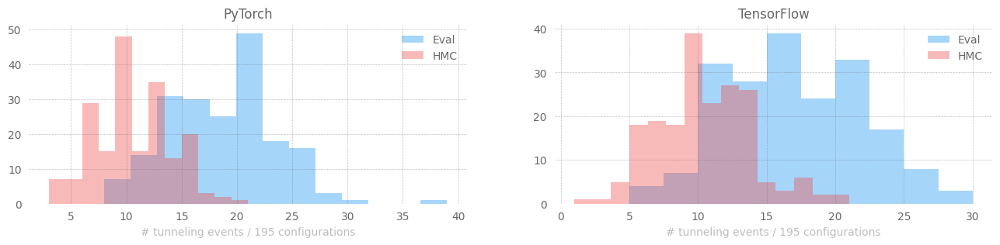

In [22]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['text.usetex'] = False
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import COLORS, set_plot_style

set_plot_style()

fig, ax = plt.subplots(figsize=(16, 3), ncols=2)

# ---------------------------------------------
# ---- DROP FIRST 20% FOR THERMALIZATION ------
# ---------------------------------------------
KEEP = int(0.8 * len(dsets['tf']['eval'].draw))
dqpte = get_thermalized_configs(dsets['pt']['eval']['dQint'].astype('int'))
dqpth = get_thermalized_configs(dsets['pt']['hmc']['dQint'].astype('int'))

dqtfe = get_thermalized_configs(dsets['tf']['eval']['dQint'].astype('int'))
dqtfh = get_thermalized_configs(dsets['tf']['hmc']['dQint'].astype('int'))

_ = sns.distplot(
    dqpte.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[0]
)
_ = sns.distplot(
    dqpth.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[0]
)

_ = ax[0].set_title('PyTorch')
_ = ax[0].set_xlabel(
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[0].legend(loc='best', frameon=False)
plt.legend()

_ = sns.distplot(
    dqtfe.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[1]
)
_ = sns.distplot(
    dqtfh.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[1]
)

_ = ax[1].set_title('TensorFlow')
_ = ax[1].set_xlabel(
    #r"""$\sum_{i=0} \left|\delta Q_{i}\right|$""",
    #fontsize='large',
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[1].legend(loc='best', frameon=False)

## TensorFlow Results

In [23]:
import rich

TensorFlow, EVAL
 dQint.sum('chain'):
 <xarray.DataArray 'dQint' (draw: 90)>
array([13, 22, 11, 25, 14, 19, 20, 25, 13, 19, 22, 18, 10, 10, 15, 12, 17,
       10, 19, 23, 17, 16, 14, 24, 16, 29, 15, 18, 16, 16, 20, 14,  5,  8,
        9, 13, 14, 20, 24, 12, 12, 15, 23, 20,  8, 14, 16, 12, 17, 28, 18,
       19, 18, 12, 27, 16, 24, 14, 21, 20, 19, 14, 14, 21, 22, 11, 22, 17,
       23, 20, 17, 15, 22, 11, 12, 13, 17, 12, 17, 24, 27, 16, 12, 13, 12,
       17, 18, 18, 16, 24])
Coordinates:
  * draw     (draw) int64 110 111 112 113 114 115 ... 194 195 196 197 198 199
dQint.sum(): <xarray.DataArray 'dQint' ()>
array(1527)
TensorFlow, HMC
 dQint.sum('chain'):
 <xarray.DataArray 'dQint' (draw: 90)>
array([ 8,  5,  9,  7, 14, 16, 12, 12, 15, 12, 10, 13, 13, 12,  8, 13, 12,
        3, 11, 12,  7, 12, 10,  6,  8, 16,  8, 17,  8,  9,  7,  1, 10, 12,
       13, 11, 21, 15, 11, 11,  7, 10,  6,  6, 13,  7,  8,  9, 11,  5, 12,
       15, 13, 10,  6, 10,  6,  8,  7,  6, 11, 12, 12, 13,  7, 16,  8, 10

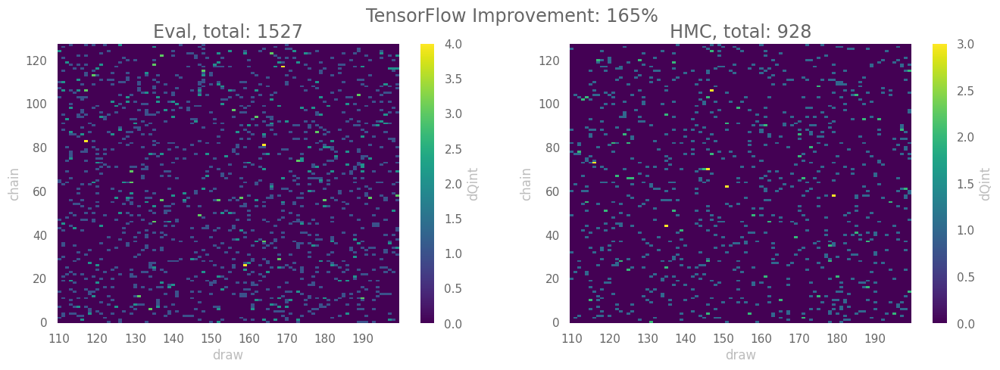

In [24]:
sns.set_context('notebook')
ndraws = len(dsets['tf']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['tf']['eval']['dQint'][:, -90:]
dqh = dsets['tf']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'TensorFlow Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

console.print(f"TensorFlow, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T}")
console.print(f"dQint.sum(): {dqe.astype(int).sum().T}")
console.print(f"TensorFlow, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T}")
console.print(f"dQint.sum(): {dqh.astype(int).sum().T}")

### PyTorch Results

------------------------------------------------------------
PyTorch, EVAL
 dQint.sum('chain'):
 [26 16 12 23 13 16 39 18 18 18 15 16 27 17 25 16 11 21 20 18 22 21 13 20
 16 19 12 26 17 16 13 17 14 18 15 15 18 23 29 20 17 23 11 16 15 15 19 22
 25 22 19 28 20 20 20 11 24 24 13 15 26 22 14 22 23 23 19 17 21 10 20 14
 16 17 19 11 21 19 15 20 13 16  9 20 21 20 21 22 23 15]
dQint.sum(): 1677
------------------------------------------------------------
PyTorch, HMC
 dQint.sum('chain'):
 [14  6 10  5  7  9 14  8 12 10 19  8  4  6  9  7  9 17  9  7 11 13  9 11
  4  9  7 14 10  6 15  6 10  9 13  7 15 10  7  9  3 14  8  6 11  9  9  6
  9  6 16  6  8 10 14 16  9 12 15 10  9  9  5  6 12 17  6  8  9 12  5 12
 16  9  7  8 11 15 16 12 12  7  5 14  9  9 13  6 12 10]
dQint.sum(): 883


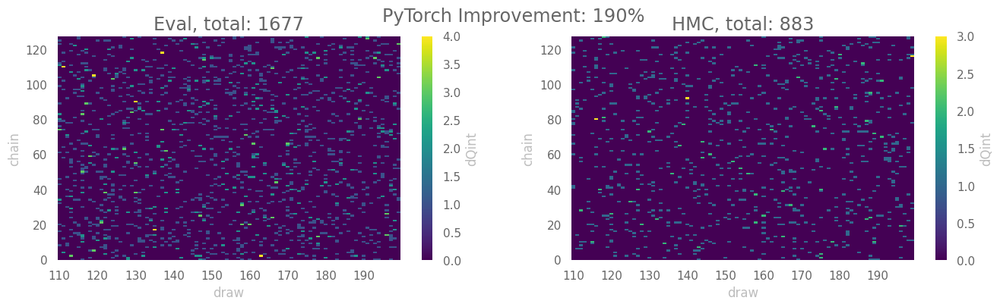

In [25]:
sns.set_context('notebook')
ndraws = len(dsets['pt']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['pt']['eval']['dQint'][:, -90:]
dqh = dsets['pt']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], 0.8 * fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'PyTorch Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

console.print(60 * '-')
console.print(f"PyTorch, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T.values}")
console.print(f"dQint.sum(): {dqe.astype(int).sum().T.values}")
console.print(60 * '-')
console.print(f"PyTorch, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T.values}")
console.print(f"dQint.sum(): {dqh.astype(int).sum().T.values}")

## Comparisons

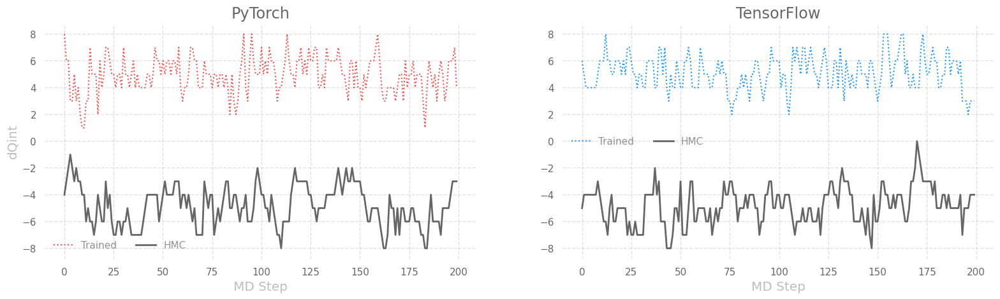

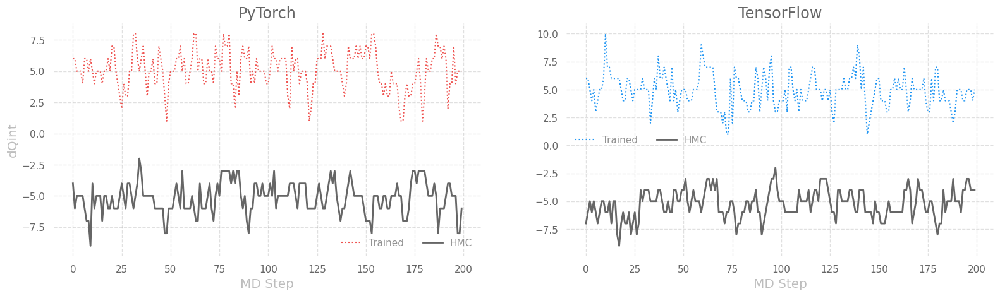

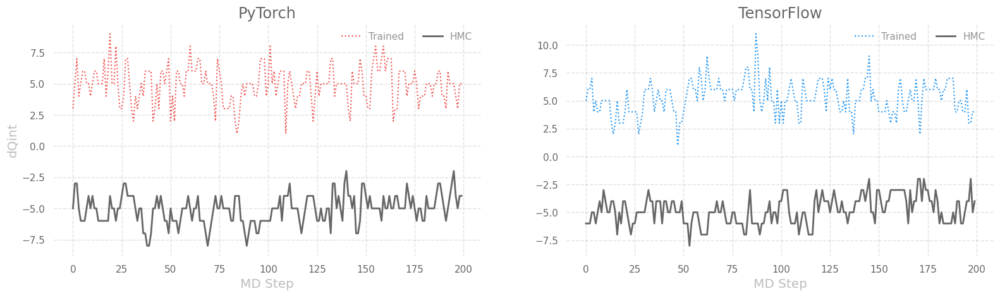

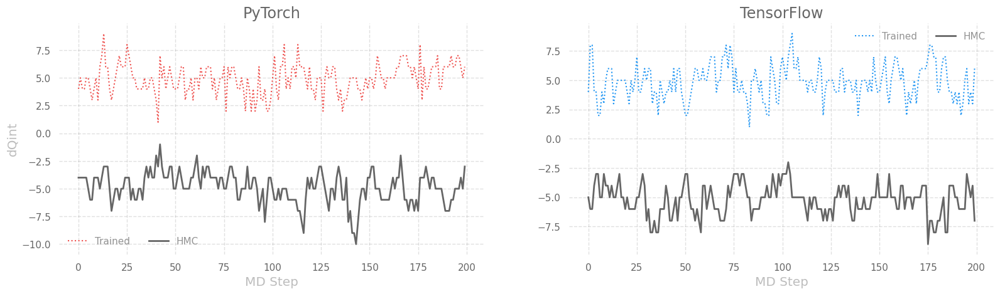

In [26]:
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import set_plot_style, COLORS

import seaborn as sns
set_plot_style()
plt.rcParams['axes.linewidth'] = 2.0
sns.set_context('notebook')
figsize = plt.rcParamsDefault['figure.figsize']
plt.rcParams['figure.dpi'] = plt.rcParamsDefault['figure.dpi']

for idx in range(4):
    fig, (ax, ax1) = plt.subplots(
        ncols=2,
        #nrows=4,
        figsize=(3. * figsize[0], figsize[1]),
    )
    _ = ax.plot(
        dsets['pt']['eval'].intQ[idx] + 5,  # .dQint.mean('chain')[100:],
        color=COLORS['red'],
        ls=':',
        label='Trained',
        lw=1.5,
    );

    _ = ax.plot(
        dsets['pt']['hmc'].intQ[idx] - 5,  # .dQint.mean('chain')[100:],
        ls='-',
        label='HMC',
        color='#666666',
        zorder=5,
        lw=2.0,
    );

    _ = ax1.plot(
        dsets['tf']['eval'].intQ[idx] + 5,  # .dQint.mean('chain')[-100:],
        color=COLORS['blue'],
        ls=':',
        label='Trained',
        lw=1.5,

    );
    _ = ax1.plot(
        dsets['tf']['hmc'].intQ[idx] - 5,  # .dQint.mean('chain')[-100:],
        color='#666666',
        ls='-',
        label='HMC',
        zorder=5,
        lw=2.0,
    );
    _ = ax.set_title('PyTorch', fontsize='x-large')
    _ = ax1.set_title('TensorFlow', fontsize='x-large')
    #_ = ax1.set_ylim(ax.get_ylim())
    _ = ax.grid(True, alpha=0.2)
    _ = ax1.grid(True, alpha=0.2)
    _ = ax.set_xlabel('MD Step', fontsize='large')
    _ = ax1.set_xlabel('MD Step', fontsize='large')
    _ = ax.set_ylabel('dQint', fontsize='large')
    _ = ax.legend(loc='best', ncol=2, labelcolor='#939393')
    _ = ax1.legend(loc='best', ncol=2, labelcolor='#939393')